### Ejercicio 1 

Dé un método de simulación a partir de la función de probabilidad $p_j$, j = 5, 6,...,14 donde:


\begin{cases} 
0.11 & \text{si } j \text{ es impar y } 5 \leq j \leq 13, \\
0.09 & \text{si } j \text{ es par y } 6 \leq j \leq 14.
\end{cases}


1. Asignamos a cada probabilidad de la función de distribución, su número de soporte correspondiente, es decir: $p_{5}=0.11,\hspace{0.3cm} p_{6}=0.09,\hspace{0.3cm} p_{7}=0.11,\hspace{0.3cm} p_{8}=0.09,\hspace{0.3cm} p_{9}=0.11,\hspace{0.3cm} p_{10}=0.09,\hspace{0.3cm}$$ 
$$p_{11}=0.11,\hspace{0.3cm} p_{12}=0.09,\hspace{0.3cm} p_{13}=0.11,\hspace{0.3cm} p_{14}=0.09$$

Entonces definimos nuesrra función en dos otras funciones, donde $p_1$ es:
$$p_1 = 0.11 + 0.11 + 0.11 + 0.11+0.11  = 0.55$$
$$p_2 = 0.09 + 0.09 + 0.09 + 0.09 + 0.09 = 0.45$$
cada función de probabilidad vale 1/5 para cada valor de x
Por lo que la función compuesta con si respectiva ponderación es:
$$f(x) = 0.55 f_1 (x)_{\{5,7,9,11,13\}} + 0.44 f_2 (x)_{\{6,8,10,12,14\}}$$
2. Generamos un número aleatorio U, entre 0 y 1.

3. Se verifica la condición $U < F$, donde $F$ es la función acumulada, si U no es menor que la probabilidad con que se comparó, se suma la siguiente probabilidad con la anterior y se vuelve a verificar la desigualdad.

4. Se termina cuando el valor de U sea mayor que las probabilidades acumuladas, en ese caso, el número asignado a la probabilidad correspondiente.

In [60]:
import numpy as np
from itertools import accumulate
def f_1():  #Declaramos función que realice los números aleatorios
    x = []  # Declaramos una lista para almacenar los resultados
    fun = [1/5,1/5,1/5,1/5,1/5]  #Declaramos la función de probabilidad
    sop =[5,7,9,11,13]
    u = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve la lista con los valores ingresados

def f_2():  #Declaramos función que realice los números aleatorios
    x = []  # Declaramos una lista para almacenar los resultados
    fun = [1/5,1/5,1/5,1/5,1/5]  #Declaramos la función de probabilidad
    sop =[6,8,10,12,14]
    u = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve la lista con los valores ingresados

def funpro(u, fun, sop):   #Funci>ón que compara el número con las probabilidades
    fun2 = sorted(fun, reverse=True) #Ordena la función de probabilidad de mayor a menor
    fun_acumulada = list(accumulate(fun2))  # Calcular la función acumulada de la función de distribución
    for i, p in enumerate(fun_acumulada):  #La función enumerate, le asigna, un número
        #a la posición en uqe se encuentre la cantidad amuculada
        #Se pone en un ciclo, para que aumente la probabilidad del intervalo
        #de acuerdo con la función acumulada
        if u < p:
            return sop[i]  # Devuelve el valor correspondiente del soporte
            #de acuerdo con la posición en que se encuentre

def fun(n):
    lista = []
    for i in range(n):
        u1 = np.random.random()
        if u1 <= 0.55:  #Verifica que el valor u1 sea menor que 0.55
            x = f_1()  #Ingresa ala función 1
            lista.append(x)
        else:         #En caso contrario ingresa a la función 2
            x = f_2()
            lista.append(x)
        
    return lista

#fun(10)

In [62]:
n = int(input("Ingrese el número de simulaciones: "))  # Se pide el número de simulaciones
simulaciones = fun(n)  # Llamamos a la función con n simulaciones
print("Simulaciones:", simulaciones)  # Imprime las simulaciones generadas


Ingrese el número de simulaciones:  10


Simulaciones: [13, 6, 13, 10, 8, 10, 13, 8, 5, 6]


Gráficamos la función de distribución acumulada:

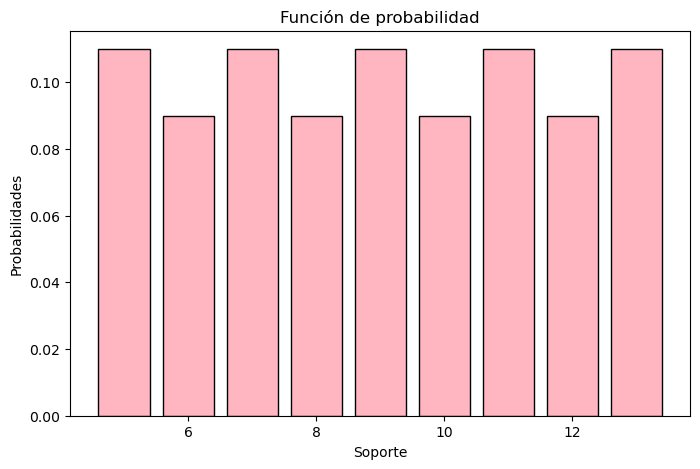

In [64]:
import matplotlib.pyplot as plt
import numpy as np

j = np.arange(5, 14) #Definimos nuestros valores del eje x

pj = [] #Lista para guardar las probabilidades
for i in j: 
    if i % 2 == 0:  # Si j es par
        pj.append(0.09)
    else:  # Si j es impar
        pj.append(0.11)

# Graficar
plt.figure(figsize=(8, 5))
plt.bar(j, pj, color='lightpink', edgecolor='black')
plt.xlabel('Soporte')
plt.ylabel('Probabilidades')
plt.title('Función de probabilidad')
plt.show()  #Muestra la gráfica 


### Ejercicio 2

Suponga que la variable aleatoria X puede tomar cualquier de los valores 1,2,...,10 con probabilidades respectivas 0.06, 0.06, 0.06, 0.06, 0.06, 0.15, 0.13, 0.14, 0.15, 0.13. Utilice el método de composición para dar un algoritmo que nete el valor de X:

Para el método de composición, tenemos a nuestra función de probabilidad definida como:
$$P(X=j)=p_1 f_1 (x) + p_2 f_2 (x)+p_3 f_3 (x) + p_4 f_4 (x)$$
1. Por lo que, dado la manera en que se encuentra definida las probabilidades, definiremos a la función $f_1$ a aquella que toma valores entre 1-5. 
Por lo que, la proporción que le toca a la función será:
$$p_1 = 0.06 + 0.06 + 0.06 + 0.06 + 0.06 = 0.3$$
Y la proporción de $f_2$ es: $$p_2 = 0.15 + 0.15 = 0.3$$, que toma valores en 6 y 9.
Y la proporción de $f_3$ es: $$p_3 = 0.13 + 0.13 = 0.26$$, que toma valores en 7 y 10.
Y la proporción de $f_4$ es: $$p_ = 0.14$$, que toma valor en 8.

Por lo que nuestra función queda como:
$$f(x) = 0.3 f_1 I_{\{1,2,3,4,5\}} (x) + 0.3 f_2 I_{\{6,9\}} (x) + 0.26 f_3 I_{\{7,10\}} (x) + 0.14 f_2 I_{\{8\}} (x)$$

3. Generamos un número aleatorio U1, y lo comparamos con las proporciones de las funciones de probabilidad, y dependiedo del intervalo en el que ingrese, se realiza la comparación con la función correspondiente. 

4. Definimos a la función $f_1$ como la función entre sus probabilidades correspondientes con su proporción, por lo que la definimos como:
$$p_{1}=\frac{1}{5},\hspace{0.3cm} p_{2}=\frac{1}{5},\hspace{0.3cm} p_{3}=\frac{1}{5},\hspace{0.3cm} p_{4}=\frac{1}{5},\hspace{0.3cm} p_{5}=\frac{1}{5}$$

Definimos a la función $f_2$ como:
$$p_{6}=0.5,\hspace{0.3cm} p_{9}=0.5$$

Definimos a la función $f_3$ como:
$$p_{7}=0.5,\hspace{0.3cm} p_{10}=0.5$$

Definimos a la función $f_4$ como: 
$$p_{8}=1$$

7. Después de verificar a que función pertenece nuestro número aleatorio. Generamos otro número aleatorio U2.

8. Se verifica la condición $U2 < F_i$, donde $F_i$ es la función acumulada de $f_1, f_2$, $f_3 y f_4$  respectivamente, si U2 no es menor que la probabilidad con que se comparó, se suma la siguiente probabilidad con la anterior y se vuelve a verificar la desigualdad.

9. Se termina cuando el valor de U2 sea mayor que las probabilidades acumuladas, en ese caso, el número asignado a la probabilidad, será el número que se imprima como el número simulado.

In [68]:
import numpy as np 
from itertools import accumulate
  
def f1():  #Declaramos función que realice los números aleatorios
    fun = [1/5,1/5,1/5,1/5,1/5]  #Declaramos la función de probabilidad
    sop =[1,2,3,4,5]
    u2 = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u2,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve el valor 
def f2():  #Declaramos función que realice los números aleatorios
    fun = [0.5,0.5]  #Declaramos la función de probabilidad
    sop =[6,9]
    u2 = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u2,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve el valor
def f3():  #Declaramos función que realice los números aleatorios
    fun = [0.5,0.5]  #Declaramos la función de probabilidad
    sop =[7,10]
    u2 = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u2,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve el valor
def f4():  #Declaramos función que realice los números aleatorios
    fun = [1]  #Declaramos la función de probabilidad
    sop =[8]
    u2 = np.random.random()  # Genera un número random entre (0,1)
    va = funpro(u2,fun, sop) #Llama a la función ingresando el valor aleatorio y tomando la función de probabilidad
    return va  # Devuelve el valor

def funpro(u, fun, sop):   #Funci>ón que compara el número con las probabilidades
    fun_acumulada = list(accumulate(fun))  # Calcular la función acumulada de la función de distribución
    for i, p in enumerate(fun_acumulada):  #La función enumerate, le asigna, un número
        #a la posición en uqe se encuentre la cantidad amuculada
        #Se pone en un ciclo, para que aumente la probabilidad del intervalo
        #de acuerdo con la función acumulada
        if u < p:
            return sop[i]  # Devuelve el valor correspondiente del soporte
            #de acuerdo con la posición en que se encuentre
                    
def f(sim):
    lista = [] #Lista para guardar los números aleatorios generados 

    for i in range(sim):
        u1 = np.random.random()
        
        if u1 <=0.3: #Se compara el número aleatorio para ver a que función corresponde
            lista.append(f1()) #Ingresa a la función 1
        elif 0.3< u1 <=0.6: 
            lista.append(f2())  #Ingresa a la función 2
        elif 0.6 < u1 <= 0.86:
            lista.append(f3())  #Ingresa a la función 3
        else:
            lista.append(f4())   #Ingresa a la función 4

    return lista

    
res=f(10)  
print("Simulaciones:", res)

Simulaciones: [2, 9, 9, 10, 10, 5, 7, 10, 9, 10]


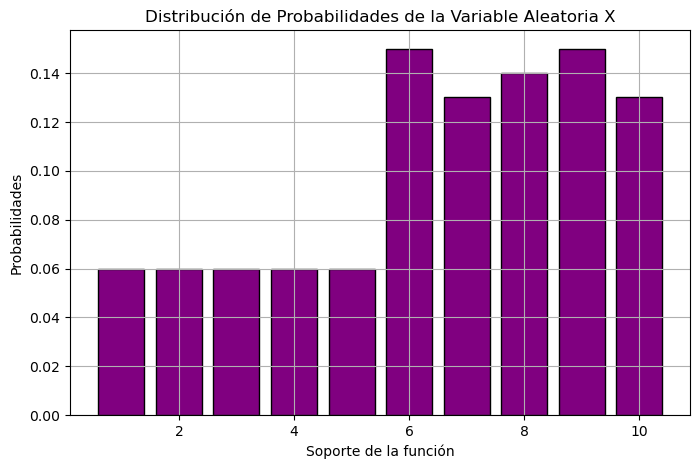

In [70]:
import numpy as np
import matplotlib.pyplot as plt

sop = np.arange(1, 11) #Soporte función 
prob = [0.06, 0.06, 0.06, 0.06, 0.06, 0.15, 0.13, 0.14, 0.15, 0.13] #Vector de probabilidades

# Graficar la distribución de probabilidades
plt.figure(figsize=(8, 5))
plt.bar(sop, prob, color='purple', edgecolor='black')

plt.xlabel('Soporte de la función')
plt.ylabel('Probabilidades')
plt.title('Distribución de Probabilidades de la Variable Aleatoria X')
plt.grid(True)
plt.show()


### Ejercicio 3

Utilice el método de composición para dar algoritmos que generen variables aleatorias a partir de las siguientes distribuciones.

#### a)

 $$F(x)= \frac{x+x^3 + x^5}{3}, \hspace{0.3cm} 0 \le x < 1$$

1. Separar la función en funciones más simples, en este caso la función se puede separar como:
$$F(x)=\frac{x}{3}+ \frac{x^3}{3} +\frac{x^5}{3}$$
Por lo que la función tendría la forma:
$$F(x)= \frac{1}{3}F_1 +  \frac{1}{3} F_2 + \frac{1}{3} F_3$$

2. Generamos un número aleatorio U1
3.  Realizamos la comparación de U1 con 1/3, si es menor que este número, generamos otro número aleatorio U2, el cual ingresará a la función inversa de $F_1$, es decir $X=U_2=F_1$

4.  Si no es menor que 1/3, se verifica que U1 se encuentre entre 1/3 y 2/3, en ese caso se generá otro número aleatorio U2, y se realizá la función inversa de $F_2$, por lo que el número aleatorio estaría en función de:
$$F_2 (x) = x^3\hspace{0.3cm} \Rightarrow \hspace{0.3cm} X = \mathrm{U}_{2}^{1/3}$$

5. En caso contario, se genera un número aleatorio U2, y se ingresa a la función inversa de $F_3$:
$$F_3 (x) = x^5 \hspace{0.3cm} \Rightarrow \hspace{0.3cm} X = \mathrm{U}_{2}^{1/5}$$
Y así generamos los números aleatorios

Ingresa el número de simulaciones: 10


[0.8553564843696037, 0.6184225703080197, 0.6362511584673773, 0.7544988715761403, 0.5644745392109136, 0.1095216837931603, 0.9560120234520203, 0.7478427989674801, 0.954525587019126, 0.8633148947056685]


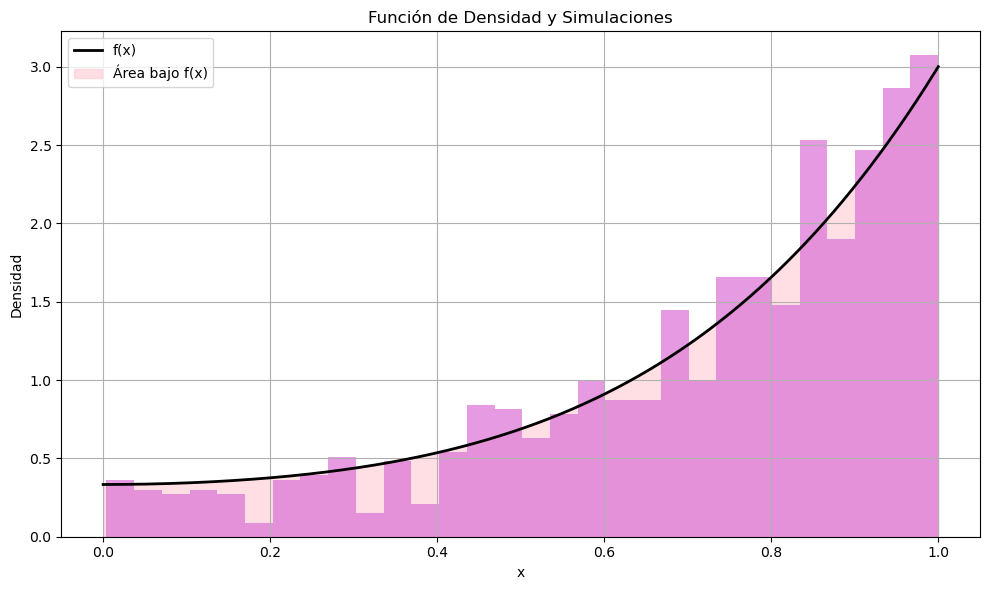

In [72]:
import numpy as np
import matplotlib.pyplot as plt

def F():
    u1 = np.random.random()
    u2 = np.random.random()
    if u1 <= 1/3:
        x = u2
        return x
    elif u1<= 2/3:
        x = u2**(1/3)
        return x
    else: 
        x = u2**(1/5)
    return x 

def com(n):
    lista=[]
    for i in range(n):
        lista.append(F())
    return lista
    
n = int(input("Ingresa el número de simulaciones:"))
s=com(n)
print(s)

# Generar 1000 puntos entre 0 y 1 para el eje x (de acuerdo al soporte de la función)
x = np.linspace(0, 1, 1000)

# Definir la función de densidad f(x)
def f(x):
    return (1 + 3*x**2 + (5*x**4)) / 3  # Derivada de la función de distribución

# Generar simulaciones aleatorias basadas en la densidad

plt.figure(figsize=(10, 6))

# Graficar la función de densidad
plt.plot(x, f(x), color='black', label='f(x)', linewidth=2)
# Rellenar el área bajo la curva
plt.fill_between(x, f(x), color='pink', alpha=0.5, label="Área bajo f(x)")

# Graficar el histograma de las simulaciones en la misma figura
plt.hist(com(1000), bins=30, density=True, alpha=0.7, color='orchid')
# Añadir etiquetas y leyenda
plt.title('Función de Densidad y Simulaciones')
plt.xlabel('x')
plt.ylabel('Densidad')
plt.grid(True)
plt.legend()

# Mostrar la gráfica
plt.tight_layout()
plt.show()


#### b)

 $$
F(x) =
\begin{cases} 
\frac{1 - e^{-2x} + 2x}{3} & \text{si } 0 < x < 1 \\
\frac{3 - e^{-2x}}{3} & \text{si } 1 < x < \infty
\end{cases}
$$

1. Por el método composición, primero verificamos la proporción que le corresponde a cada función, para ello evaluamos la función de distribución en el salto:
$$F(1)= \frac{1-e^-2 + 2}{3} = 0.95$$
Por lo que la función de distribución compuesta es:
$$F(x) = 0.95 F_1 (x) 1_{(0,1)} + 0.05 F_2 (x) 1_{(1,\infty)}$$

2. Sin embargo la función de distribución 1, tambien se puede ver como una composición de funciones, por lo que la función compuesta se podría expresar como:
$$F_1 (x) = \frac{1}{3} G_1 (x) + \frac{2}{3} G_2 (x)$$
$$F_1 (x) = \frac{1}{3} (1-e^{-2x}) + \frac{2}{3} x$$
Y la función $F_2$ se quedaría de la misma manenra.

3. El paso siguiente sería generar un número aleatorio U1, el cual se compararía con la proporcion 0.95, si el número aleatorio U1 es menor que 0.95, ingresa a la función $F_1 (x)$ y en caso contrario ingresa a la función $F_2 (x)$

4. En caso de que ingrese a la fucnión $F_1 (x)$, generamos otro número aleatorio U2, para que se compare con la proporción $\frac{1}{3}$ si es menor que la proporción ingresa la función $G_1 (x)$ en caso contrario ingresa a la función $G_2 (x)$

5. Para el caso en que entrará en la función $F_1 (x)$ y despúes a la función $G_1 (x)$ como tiene forma exponencial, generariamos otro número aleatorio U3, y lo ingresariamos a la función inversa de una exponencial, la cual sería:

$$ x = -\frac{1}{2}In(U_3)$$ y la inversa de la función $G_2 (x) $ sería $x = U_3$


6. Para el caso de que ingrese a la función $F_2 (x)$ y aplicamos el método de la transformaada inversa, por lo que sería:
$$ u = \frac{3-e^{-2x}}{3} \hspace{0.3cm} \Rightarrow \hspace{0.3cm} x = -\frac{In(3-3u)}{2}$$

In [74]:
import numpy as np
def f():
    u1 = np.random.random()
    if u1 <= 0.95:
        u2 = np.random.random()
        if u2 <= 1/3:
            u3 = np.random.random()
            x = -(1/2)*np.log(u3)
            return x
        else:
            u3 = np.random.random()
            x = u3
            return x
    else: 
        u3 = np.random.random()
        x = -(np.log(3-3*u3))/2
        return x


def com(n): #Función para realizar n simulaciones en f(x)
    lista=[]
    for i in range(n): #Ciclo para las simulaciones 
        lista.append(f())
    return lista

n = int(input("Ingresa el número de simulaciones:"))

s = com(n)
print(s)

    

Ingresa el número de simulaciones: 10


[0.03590018503962833, 0.6209851626647692, 0.6359540702241302, 0.7063926618050839, 0.37887020415299544, 0.8915057836116754, 0.4517469450247702, 0.16254183514175613, 0.8298063089670371, 0.7924240004696878]


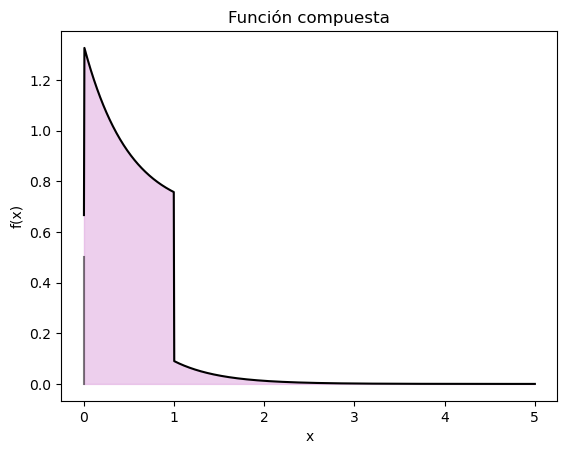

In [76]:
import numpy as np
import matplotlib.pyplot as plt

# Genera 1000 puntos entre 0 y 5 para el eje x (parte positiva de la función).
x1 = np.linspace(0, 5, 1000)

# Definir la función de densidad f(x)
def f(x):
    if 0 < x < 1:
        return (2*np.exp(-2*x))/3 + 2/3
    else:
        return (2*np.exp(-2*x))/3

# Vectorizar la función para que pueda manejar arrays
f_vec = np.vectorize(f)

# Establece el título del gráfico.
plt.title("Función compuesta")

# Grafica la función de densidad para la parte positiva de x (x >= 0).
plt.plot(x1, f_vec(x1), color="black", label="f1")

# Rellena el área bajo la curva para la parte positiva de x, con color azul claro y algo de transparencia.
plt.fill_between(x1, f_vec(x1), color= "plum", alpha=0.5, label="f1")

# Dibuja una línea vertical en x = 0 que representa la simetría de la distribución, con algo de transparencia.
plt.plot(np.zeros(1000), np.linspace(0, 0.5, 1000), color="black", alpha=0.5)

# Etiqueta para el eje y.
plt.ylabel("f(x)")

# Etiqueta para el eje x.
plt.xlabel("x")

# Muestra el gráfico.
plt.show()


#### c)

 $$F(x)=\sum_{i=1} \alpha_i x^i \hspace{0.3cm} 0\le x \le 1, \hspace{0.3cm} \alpha_i \ge0, \hspace{0.3cm} \sum_{i=1}^n \alpha_i = 1$$

1. En esta función, depende de el número de funciones que quiera el usuario junto con la ponderación respectiva de cada función.

2. Definir el número de funciones (i)

3. Establecer la ponderación de cada función correspondiente:
$$F(x) = \alpha_1 F_1(x) + \alpha_2 F_2(x)+...+ \alpha_i F_i(x)$$
Y se debe cumplir que $\sum_{i=1}^n \alpha_i = 1$

4. Por lo que se genera un número aleatorio U1, y se verifica si el número aleatorio es que menor que la ponderación correspondiente.

5. En caso de que entre en cualquier condición, se generá otro número aleatorio U2 y se realizá el método de transformada inversa con su respectivo i, para obtener el valor de x:
$$ u = x^i \hspace{0.3cm} \Rightarrow \hspace{0.3cm} x = u^{\frac{1}{i}}$$

Ingresa el número de simulaciones: 10
Ingrese el vector de probabilidades separado por comas:  0.5,0.5


Vector de probabilidades: [0.5, 0.5]
[0.18939623398444994, 0.9506555936391244, 0.9239353898174291, 0.3364477969910319, 0.40926622655724093, 0.4179991645986328, 0.2874873836410037, 0.6053792383076368, 0.3253772473556219, 0.7725148146480036]


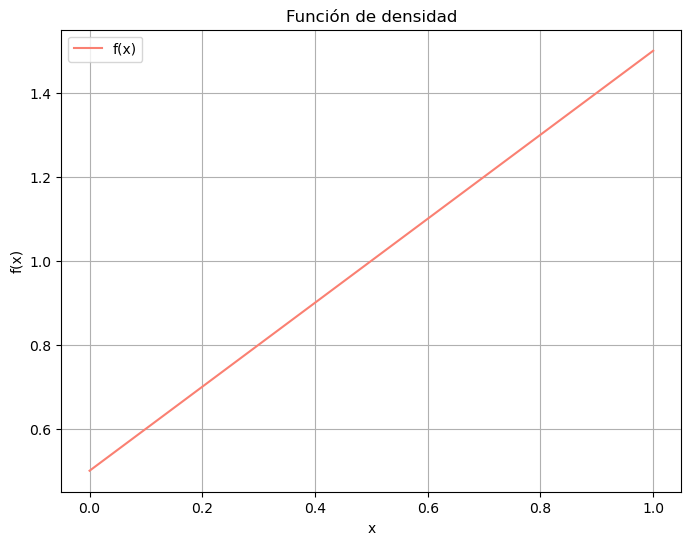

In [80]:
import numpy as np
from itertools import accumulate

def com(n,pon): #Función para realizar n simulaciones en f(x)
    lista=[]
    i = len(pon) 
    for h in range(n): #Ciclo para las simulaciones 
        lista.append(F(i,pon))
    return lista

def arreglo(i):
    return list(range(1, i + 1))

def F(i,pon):
    arre = arreglo(i)
    pon_acu = list(accumulate(pon))
    u1 = np.random.random()
    for j, p in enumerate(pon_acu):
        if u1 <= p:
            u2 = np.random.random()
            x = u2**(1/arre[j])
            return x


n = int(input("Ingresa el número de simulaciones:"))
prob = input("Ingrese el vector de probabilidades separado por comas: ")
pon = [float(p) for p in prob.split(",")]

# Imprime el vector de probabilidades ingresado por el usuario.
print("Vector de probabilidades:", pon)
s = com(n,pon)
print(s)




######### 

import numpy as np
import matplotlib.pyplot as plt

i = len(pon)
# Definir la derivada de F'(x)
def f(x):
    return sum(pon[r] * (r+1) * x**r for r in range(i))

# Generar valores de x entre 0 y 1
x1 = np.linspace(0, 1, 500)

# Calcular los valores de F'(x) para cada valor de x
y1 = [f(x) for x in x1]

plt.figure(figsize=(8,6))
plt.plot(x1, y1, label="f(x)", color="salmon")
plt.title("Función de densidad")
plt.xlabel("x")
plt.ylabel("f(x)")
plt.grid(True)
plt.legend()

# Mostrar el gráfico
plt.show()


### Ejercicio 4

Supongamos que X se distribuye como pomposición de tres variables aleatorias normales $N(\mu, \sigma^2)$ con $\mu= (-3,0,3), \hspace{0.3cm} \sigma = (1,1,1,)$ y ponderación $p=(1/3,1/3,1/3)$. Dar el algoritmo de composición para este método.

1. Pero como en este caso es una composición de variables, vamos a dividir la función como la suma de 3 variables normales, por lo que, la ponderación cada variable será de $\frac{1}{3}$ respectivamente.

2. Generamos un número aleatorio, y verificamos si las siguientes condiciones:

Si $U \in [0,\frac{1}{3}]$ generamos $X\sim N(-3,1)$

Si no $U \in (\frac{1}{3},\frac{2}{3}]$ generamos $X\sim N(0,1)$, una variable normal estándar

Si no $U \in [\frac{2}{3},1]$ generamos $X\sim N(3,1)$


3. Para todas las variables, sin importar el intervalo al que pertenezcan, generamos $Y_1 , Y_2$ variables aleatorias exponenciales con media 1, para generar las exponenciales se utiliza el método de la transformada inversa. Por lo que, generamos $U_1 , U_2$ números random y los ingresamos a la función.
$$ y = -\frac{1}{1}In(U)$$ 

4. Se realiza la compraración $Y_2 \le (Y_1 - 1)^2 / 2$, en caso de que si sea cierto $X=Y$ Y si no se cumple, se regresa al paso 1.

5. Generamos un ciclo en el que generemos un numeros aleatorio U y si es menor a 0.5, entonces $X= Y_1$ y si no, $X=-Y_1$
Esto se realiza para encontrar una variable que tenga distribución Normal estándar, con media 0 y varianza 1

6. Y para generar una variable X normal con media $\mu$ y varianza $\sigma$. Unicamente realizamos el despeje de la variable X que se quiere estandarizar.
$$ Z = \frac{X-\mu}{\sigma} \hspace{0.3cm} \Rightarrow \hspace{0.3cm} X= \sigma Z+\mu$$ y se aplica a nuestras variables.



In [74]:
import numpy as np
import matplotlib.pyplot as plt  # Importa la biblioteca Matplotlib para crear gráficos.

def rnormalstd():   #Función para normal estándar
        u1 = np.random.random() #Gneneramos números aleatorios
        u2 = np.random.random()
        y1=-np.log(u1)   #Por el método de transformada inversa, evaluamos en una función exponencial
        y2=-np.log(u2)
        while(y2>=((y1-1)**2)/2):  #Comparamos los valores generados
            u1 = np.random.random()  #Generamos otro par de números aleatorios
            u2 = np.random.random()
            y1=-np.log(u1)   #VOlvemos a ingresar a la función inversa de la exponencial
            y2=-np.log(u2)
        if np.random.random()<0.5:  #Para obtener la normal estandar en todo su soporte
            x = y1        #Comparamos los valores generados del valor absoluto de la normal
        else:             # y dependiendo de la condición es el signo que les corresponde
            x = -y1
        return x
    
def rnorm(media, desv):  #Función para obtener el valor de una normal
    return desv * rnormalstd()+media  #A los valores generados de una normal estándar, los multiplicamos por 
                                    #su desviación estándar y les sumamos su media 
def f():
    u1 = np.random.random()   #Generamos un pseudo aleatorio para ver que tipo de distribución normal
    if u1 <= 1/3:             #le corresponde, de acuerdo con su ponderación
        x = rnorm(-3,1)     #Ingresa a la función normal 
        return x
    elif u1<= 2/3:
        x = rnormalstd()     #Ingresa a la función normal estándar
        return x
    else: 
        x = rnorm(3,1)      #Ingresa a la función normal
        return x 

def com(n): #Función para realizar n simulaciones en f(x)
    lista=[]
    for i in range(n): #Ciclo para las simulaciones 
        lista.append(f())
    return lista

n = int(input("Ingresa el número de simulaciones:"))
s = com(n)
print(s)


Ingresa el número de simulaciones: 10


[3.7587403611288526, 3.901507985608949, -3.633179320033448, -1.7498157160904608, -1.0845914556915133, 2.2026068373356837, 4.635373874798283, 3.6952775404968707, -3.4183584365050272, 0.562274869288357]


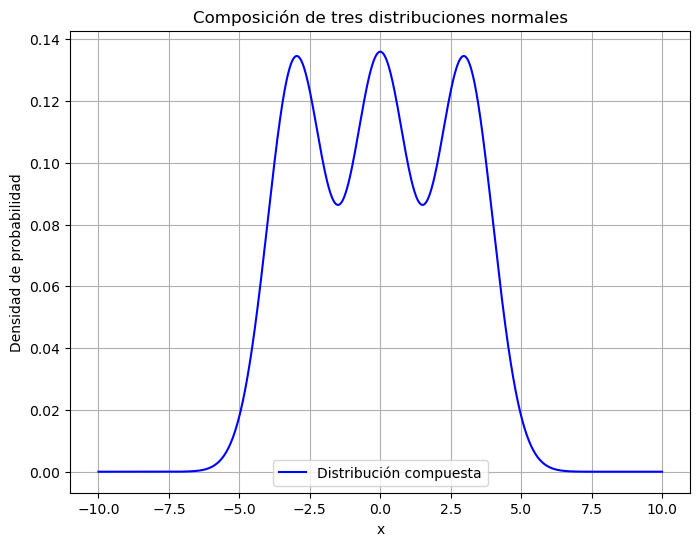

In [88]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# Parámetros de las distribuciones
mus = np.array([-3, 0, 3])  # Medias
sigmas = np.array([1, 1, 1])  # Desviaciones estándar
pon = np.array([1/3, 1/3, 1/3])  # Ponderaciones

# Generar puntos para el eje x
x = np.linspace(-10, 10, 1000)

pdf_vals = np.zeros_like(x)

# Calcular la función de densidad de la mezcla de las 3 normales
for i in range(3):
    pdf_vals += pon[i] * norm.pdf(x, mus[i], sigmas[i])

# Graficar la distribución compuesta
plt.figure(figsize=(8,6))
plt.plot(x_vals, pdf_vals, label="Distribución compuesta", color='black')
plt.title("Composición de tres distribuciones normales")
plt.xlabel("x")
plt.ylabel("Densidad de probabilidad")
plt.grid(True)
plt.legend()

# Mostrar la gráfica
plt.show()


### Ejercicio 5

#### a)

Emplee la simulación por aproximación las siguientes integrales. Comprare su estimación con la respuesta exacta, si ésta se conoce.

$$\int_{0}^{1} exp(e^x)dx$$

1. Generamos N números aleatorios uniformes en (0,1)
2. Evaluamos $f(x) = exp(e^x) dx$ en los números aleatorios generados
3. Promediamos los valores obtenidos del punto 2

In [102]:
import numpy as np

def monte(n):
    lista=[]  #Creamos lista
    u = np.random.random(n)  #Generamos los n números aleatorios
    x=(np.exp(np.exp(u))).mean() #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y obtenemos la media 
    
    return x


print("Valor simulación:",monte(10000))

Valor simulación: 6.295265391906801


Valor exacto integral : 6.31656

#### b)

$$\int_{0}^{1} (1-x^2 )^\frac{3}{2} dx$$

1. Generamos N números aleatorios uniformes en (0,1)
2. Evaluamos $f(x) = (1-x^2)^{\frac{3}{2}} dx$ en los números aleatorios generados
3. Promediamos los valores obtenidos del punto 2

In [98]:
import numpy as np

def monte(n):
    lista=[]   #Creamos lista
    u = np.random.random(n)  #Generamos los n números aleatorios 
    x=((1-u**2)**(3/2)).mean() #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y obtenemos el promedio
    
    return x


print("Valor simulación:",monte(10000))

Valor simulación: 0.5865505153148378


valor exacto integral: 0.58905

#### c)

$$ \int_{-2}^{2} e^{x+x^2}dx$$

1. Cambiamos los límites de integración, con la sustitución:
 $$ \int_{0}^{1} e^{(-2+[2-(-2)y)+(-2+[2-(-2)y)^2}*4dx$$
2. Generamos N números aleatorios uniformes en (0,1)
3. Evaluamos $ \int_{0}^{1} e^{(-2+[2-(-2)y)+(-2+[2-(-2)y)^2}*4dx $en los números aleatorios generados
4. Promediamos los valores obtenidos del punto anterior

In [115]:
#c)
import numpy as np

def monte(n):
    lista=[]   #Generamos lista
    u = np.random.random(n)  #Generamos los n números aleatorios 
    x=((np.exp((-2+4*u)+(-2+4*u)**2))*4).mean() #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y obtenemos la media 
    
    return x


print("Valor simulación:",monte(10000))

Valor simulación: 93.74804311023493


valor exacto: 93.1628

#### d)

$$ \int_{-2}^{2} e^{x+x^2}dx$$

1. Cambiamos los límites de integración, con la sustitución:
 $$ \int_{0}^{1} e^{(-2+[2-(-2)y)+(-2+[2-(-2)y)^2}*4dx$$
2. Generamos N números aleatorios uniformes en (0,1)
3. Evaluamos $ \int_{0}^{1} e^{(-2+[2-(-2)y)+(-2+[2-(-2)y)^2}*4dx $en los números aleatorios generados
4. Promediamos los valores obtenidos del punto anterior

In [127]:
#d)
import numpy as np

def monte(n):
    lista=[]  #Creamos lista
    u = np.random.random(n)  #Generamos n números aleatorios
    x=((np.exp((-2+4*u)+(-2+4*u)**2))*4).mean() #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y obtenemos media
    
    return x


print("Valor simulación:",monte(10000))

Valor simulación: 93.21160984650754


valor exacto: 93.1628

#### e)

$$\int_{0}^{\infty} x (1+x^2)^{-2} dx$$ 

1. Cambiamos los límites de integración, con la siguiente transformación
$$ \theta = \int_0^1 \frac{g(\frac{1}{y} - 1)}{y^2} dy$$
2. Generamos N números pseudo aleatorios en [0,1]
3. Evaluamos la nueva función $$f(x) = \int_0^1 \frac{(\frac{1}{y}-1)(1+(\frac{1}{y}-1)^2)^{-2}}{y^2} dy$$ en todos los N números
4. Promediamos los valores del paso anterior

In [143]:
#e
import numpy as np
def monte(n):
    lista=[]
    u = np.random.random(n)
    #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y se obtiene el promedio
    x = ((((1/u)-1) * ((1 + ((1/u) - 1)**2)**(-2)) ) / (u ** 2)).mean()
    return x


print("Valor simulación:",monte(10000))

Valor simulación: 0.49796119240698616


valor exacto e: 0.5

#### f)

$$\int_{0}^{1} \int_{0}^{1} e^{(x+y)^2} dydx$$ 

1. Como ambas integrales tienen límites de integración entr 0 y 1, se mantienen igual
2. Generamos N y M números pseudo aleatorios entre 0 y 1, de la misma longitud
3. Evaluamos $f(x)$ con los respectivos números aleatorios, es decir, $x=N$ y $y=M$
4. Promediamos los valores obtenidos

In [169]:
#f)
import numpy as np
    
u1 = np.random.random(1000)  #Generamos números aleatorios
u2 = np.random.random(1000)
x=(np.exp((u1+u2)**2)).mean() #Se hace la evaluación de los números pseudoaleatorios en el argumento de la integral y obtenemos el promdio 
   

print("Valor simulación:", x)

Valor simulación: 4.954626704455226


valor exacto: 4.89999

#### g)

$$\int_{0}^{\infty} \int_{0}^{x} e^{-(x+y)} dydx$$ 
$$1_y(x) = 
\begin{cases} 
1 & \text{si } y < x \\
0 & \text{si } y \geq x 
\end{cases}$$

Utilice esta función para igualar esta integral a otra cuyos términos vayan de 0 a $\infty$

1. Cambiamos nuestros límtes de integración de la primer integral, para que ambas vayan de 0 a $\infty$
$$\int_{0}^{\infty} \int_{0}^{x} e^{-(x+y)} dydx \hspace{0.3cm}=\hspace{0.3cm} \int_{0}^{\infty} \int_{0}^{\infty} \mathrm{1}_{[0,x]}^{(y)} e^{-(x+y)} dydx $$

2. Cambiamos los límites de integración para que ambas vayan de 0 a 1
$$\int_{0}^{\infty} e^{-x} \int_{0}^{1}\frac{\mathrm{1}_{[0,x]}^{(\frac{1}{y}-1)} e^{-(\frac{1}{y}-1)}}{y^2} dydx \hspace{0.3cm}=\hspace{0.3cm}\int_{0}^{1}\int_{0}^{1} \frac{e^{-(\frac{1}{x}-1)}}{x^2}\frac{\mathrm{1}_{[0,x]}^{(\frac{1}{y}-1)} e^{-(\frac{1}{y}-1)}}{y^2} dydx$$

Ya que tenemos las integrales definidad de 0 a 1.

1. Generamos N y M números aleatorios uniformes en (0,1)
2. Evaluamos $f(x)$ en los números aleatorios generados, con sus respectivos valores, $x=N$ y $y=M$
3. Promediamos los valores obtenidos del punto anterior

In [8]:
import numpy as np

# Función indicadora
def indicadora(u1, u2):
    return np.where((1/u2)-1 < u1, 1, 0) #Verificamos que el valor del argumento sea menor que nuestro límite superior 

# Función de Monte Carlo
def monte(n):
    u1 = np.random.random(n)  #Generamos números aleatorios
    u2 = np.random.random(n)
    
    # Se hace la evaluación de los números pseudo aleatorios en el argumento de la integral y se obtiene el promedio
    x = ((np.exp(-((1/u1)-1)))/(u1**2)) * ((np.exp(-((1/u2)-1)))/(u2**2)) * indicadora(u1, u2)
    
    return x.mean()  # Aplicar mean() al array resultante para obtener el promedio

# Llamar la función monte con 10000 muestras
resultado = monte(10000)
print("Valor simulación:",resultado)


Valor simulación: 0.43456838062324005


Valor exacto: 0.5

### Ejercicio 6

Utilice la simulación para aproximar $Cov(U, e^U)$ donde U es uniforme en (0,1). Compare su aproximación con la respuesta exacta.

$$ cov\left(u,\:e^u\right)=E\left(ue^u\right)-E\left(u\right)E\left(e^u\right) $$

$$\int _0^1ue^udu-\int _0^1udu\:\int _0^1e^udu $$

$$ e-\int _0^1e^udu-\:\left(\int _0^1u\:du\int _0^1e^udu\:\right)\:\: $$

$$ \left(e-e+1\right)-\left(\frac{e-1}{2}\:\right)\: $$

$$ \frac{3-e}{2}\: $$

$$ cov\left(u,\:e^u\right)=E\left(ue^u\right)-E\left(u\right)E\left(e^u\right) $$

$$\int _0^1ue^udu-\int _0^1udu\:\int _0^1e^udu $$

$$ e-\int _0^1e^udu-\:\left(\int _0^1u\:du\int _0^1e^udu\:\right)\:\: $$

$$ \left(e-e+1\right)-\left(\frac{e-1}{2}\:\right)\: $$

$$ \frac{3-e}{2}\: $$

#### Montecarlo

$$ cov\left(u,\:e^u\right)=E\left(ue^u\right)-E\left(u\right)E\left(e^u\right) $$

$$\int _0^1ue^udu-\int _0^1udu\:\int _0^1e^udu $$

$$ \sum _{i=1}^n\left(u_ie^{u_i}\right)-\left(\sum \:_{i=1}^n\left(u_i\right)\cdot \sum \:_{i=1}^n\left(e^{u_i}\right)\right) $$

1. **Generación de números aleatorios uniformes**: La función genera \( n \) números aleatorios \( u \) con una distribución uniforme en el intervalo \([0, 1]\). Esto se realiza usando la función `np.random.random(n)`.

2. **Transformación de los números aleatorios**:  
   Para cada número aleatorio generado \( u_i \), se calcula su exponencial, es decir, \( e^{u_i} \), y se almacena en la variable `eu`.

3. **Cálculo del valor esperado de la transformación**:  
   Se calcula una transformación específica de \( u \) y \( eu \), dada por la expresión:
   $$
   (u_i \cdot e^{u_i}) - \left( \frac{1}{2} \cdot e^{u_i} \right)
   $$
   Luego, se obtiene el promedio de esta transformación para todos los valores de \( u \). Esta operación sirve como una estimación Monte Carlo del valor esperado de la función dada.

4. **Comparación con el valor exacto**:  
   Se calcula el valor exacto de la función que se está estimando, el cual es:
   $$
   \frac{3 - e}{2}
   $$
   Este valor exacto se asigna a la variable `exacto` y se imprime para poder comparar la estimación Monte Carlo (\( x \)) con el valor teórico (`exacto`).

5. **Devolución del resultado**:  
   La función devuelve el valor estimado \( x \), que es el promedio calculado de la transformación de los números aleatorios generados.

In [1]:
import numpy as np

# Función que realiza una simulación de Monte Carlo
def monte6(n):
    # Generar 'n' números aleatorios uniformes entre 0 y 1
    u = np.random.random(n)

    # Calcular el exponencial de cada número aleatorio
    eu = np.exp(u)

    # Calcular la media de las variables aleatorias transformadas basadas en la expresión:
    # (u * eu) - (1/2) * eu
    # Esta es la principal calculación para la estimación de Monte Carlo
    x = ((u * eu) - ((1/2) * eu)).mean()

    # Calcular el valor exacto de la expresión que se está estimando
    exacto = (3 - np.exp(1)) / 2

    # Imprimir el valor exacto para comparación
    print("el valor exacto es:", exacto)

    # Devolver el valor medio estimado de la simulación de Monte Carlo
    return x

In [3]:
monte6(1000000)

el valor exacto es: 0.14085908577047745


0.14137320754016913

### Ejercicio 7

Sea U uniforme en (0,1).Utilice simulación para aproximar lo siguiente:

#### a)

$$cov\left(u,\:\sqrt{1-u^2}\right)=E\left(u\sqrt{1-u^2}\right)-E\left(u\right)E\left(\sqrt{1-u^2}\right)\:$$

$$\int _0^1u\sqrt{1-u^2}du-\int _0^1udu\:\int _0^1\sqrt{1-u^2}du $$

$$ ( u = 1 - x^2 ),  entonces  ( du = -2x , dx ) o  ( x , dx = -\frac{1}{2} du ) $$

$$ -\frac{1}{2} \int_1^0 \sqrt{u} \, du = \frac{1}{2} \int_0^1 u^{1/2} \, du $$

$$ \frac{1}{2} \cdot \frac{2}{3} u^{3/2} \bigg|_0^1 = \frac{1}{3} $$

$$\int_0^1 x \, dx = \frac{1}{2} x^2 \bigg|_0^1 = \frac{1}{2}$$

$$\int_0^1 \sqrt{1-x^2} \, dx = \frac{\pi}{4}$$

$$\left( \int_0^1 x \, dx \right) \cdot \left( \int_0^1 \sqrt{1-x^2} \, dx \right) = \frac{1}{2} \cdot \frac{\pi}{4} = \frac{\pi}{8}$$


$$\int_0^1 x \sqrt{1-x^2} \, dx - \left( \int_0^1 x \, dx \cdot \int_0^1 \sqrt{1-x^2} \, dx \right) = \frac{8-3\pi }{24}$$

1. **Generación de números aleatorios uniformes**:
   - La función genera `n` números aleatorios \( u \) uniformemente distribuidos en el intervalo \([0, 1]\), usando `np.random.random(n)`.

2. **Transformación de los números aleatorios**:
   - Para cada número aleatorio generado \( u_i \), se calcula la siguiente transformación:
   $$
   \left((1 - u_i^2)^{\frac{1}{2}}\right)
   $$
   Esto se almacena en la variable `r`.

3. **Cálculo de la estimación de Monte Carlo**:
   - Se calcula la función combinada de `u` y `r` con la siguiente expresión:
   $$
   \left(u_i \cdot r_i\right)-\left(\frac{r_i}{2}\:\right)\:
   $$
   - Luego, se obtiene el promedio de esta expresión para todos los valores de \( u \). Este promedio, almacenado en `x`, es la estimación de Monte Carlo del valor esperado de la función.

4. **Comparación con el valor exacto**:
   - Se calcula el valor exacto de la integral que se quiere estimar:
   $$
   \left(\frac{8 - 3\pi}{24}\right)
   $$
   - Este valor exacto se guarda en la variable `exacto` y se imprime para poder compararlo con la estimación Monte Carlo.

5. **Retorno del resultado**:
   - La función devuelve el valor estimado `x`, que es el promedio calculado de la transformación de los números aleatorios.

In [8]:
import numpy as np

# Función que realiza una simulación de Monte Carlo para estimar una integral específica
def monte7(n):
    # Genera 'n' números aleatorios uniformemente distribuidos en el intervalo [0, 1]
    u = np.random.random(n)

    # Calcula una transformación 'r' basada en los números generados 'u'
    # Específicamente, r se calcula como (1 - u^2)^(1/2)
    r = ((1 - (u**2))**(1/2))

    # Calcula el promedio de las variables transformadas usando la expresión:
    # (u * r) - (r / 2)
    # Esta expresión forma la base de la estimación de Monte Carlo
    x = ((u * r) - (r / 2)).mean()

    # Calcula el valor exacto de la expresión que se está estimando
    exacto = (8 - (3 * np.pi)) / 24

    # Imprime el valor exacto para hacer una comparación
    print("El valor exacto es:", exacto)

    # Retorna el valor promedio estimado a partir de la simulación de Monte Carlo
    return x


In [9]:
monte7(1000000)

El valor exacto es: -0.059365748365390804


-0.05936033819080417

 #### b)

$$cov\left(u^2,\:\sqrt{1-u^2}\right)=E\left(u^2\sqrt{1-u^2}\right)-E\left(u^2\right)E\left(\sqrt{1-u^2}\right)\:$$

$$\int _0^1u^2\sqrt{1-u^2}du-\int _0^1u^2du\:\int _0^1\sqrt{1-u^2}du $$


$$\int _0^1u^2\sqrt{1-u^2}du\:= $$
$$
\int_0^{\frac{\pi}{2}} \sin^2(\theta) \cos^2(\theta) \, d\theta
$$

 $$( \sin^2(\theta) \cos^2(\theta) = \left(\frac{1}{2} \sin(2\theta)\right)^2 = \frac{1}{4} \sin^2(2\theta) ):
$$
$$
\int_0^{\frac{\pi}{2}} \frac{1}{4} \sin^2(2\theta) \, d\theta
$$

$$
\frac{1}{4} \int_0^{\pi} \sin^2(\phi) \frac{d\phi}{2} = \frac{1}{8} \int_0^{\pi} \sin^2(\phi) \, d\phi
$$

$$
\frac{1}{8} \cdot \frac{\pi}{2} = \frac{\pi}{16}
$$

$$
\int_0^1 u^2 \, du = \frac{1}{3} u^3 \Bigg|_0^1 = \frac{1}{3}
$$

$$
\int_0^1 \sqrt{1-u^2} \, du = \frac{\pi}{4}
$$

$$
\frac{\pi}{16} - \left(\frac{1}{3} \cdot \frac{\pi}{4}\right) = \frac{\pi}{16} - \frac{\pi}{12}
$$

$$
\frac{3\pi}{48} - \frac{4\pi}{48} = -\frac{\pi}{48}
$$



1. **Generación de números aleatorios uniformes**:
   - La función genera `n` números aleatorios \( u \) uniformemente distribuidos en el intervalo \([0, 1]\), usando `np.random.random(n)`.

2. **Transformación de los números aleatorios**:
   - Para cada número aleatorio generado \( u_i \), se calcula la siguiente transformación:
   $$
   \left((1 - u_i^2)^{\frac{1}{2}}\right)
   $$
   Esto se almacena en la variable `r`.

3. **Cálculo de la estimación de Monte Carlo**:
   - Se calcula la función combinada de `u` y `r` con la siguiente expresión:
   $$
   \left(u_i^2 \cdot r_i\right)-\left(\frac{r_i}{3}\:\right)\:
   $$
   - Luego, se obtiene el promedio de esta expresión para todos los valores de \( u \). Este promedio, almacenado en `x`, es la estimación de Monte Carlo del valor esperado de la función.

4. **Comparación con el valor exacto**:
   - Se calcula el valor exacto de la integral que se quiere estimar:
   $$
   \left(-\frac{\pi}{48}\right)
   $$
   - Este valor exacto se guarda en la variable `exacto` y se imprime para poder compararlo con la estimación Monte Carlo.

5. **Retorno del resultado**:
   - La función devuelve el valor estimado `x`, que es el promedio calculado de la transformación de los números aleatorios generados.

In [10]:
import numpy as np
def monte7b(n):
    # Genera 'n' números aleatorios uniformemente distribuidos en el intervalo [0, 1]
    u = np.random.random(n)

    # Calcula una transformación 'r' basada en los números generados 'u'
    # Específicamente, r se calcula como \( (1 - u^2)^{1/2} \)
    r = ((1 - (u**2))**(1/2))

    # Calcula el promedio de las variables transformadas usando la expresión:
    # $$ \left(u_i^2 \cdot r_i\right)-\left(\frac{r_i}{3}\:\right)\: $$
    # Esta expresión forma la base de la estimación de Monte Carlo
    x = (((u**2) * r) - (r / 3)).mean()

    # Calcula el valor exacto de la expresión que se está estimando
    # $$ \left(-\frac{\pi}{48}\right) $$
    exacto = -((np.pi) / 48)

    # Imprime el valor exacto para hacer una comparación
    print("El valor exacto es:", exacto)

    # Retorna el valor promedio estimado a partir de la simulación de Monte Carlo
    return x


In [11]:
monte7b(1000000)

El valor exacto es: -0.06544984694978735


-0.06553387254029211

### Ejercicio 8

Sea $(X,Y)$ con función de densidad $$f(x,y)=e^{-y}$$ cuando $0<x<y$ y que vale 0 en otro caso:

#### a)

Simular $Y$ y $X|Y$

1. **Generación de números aleatorios uniformes**:
   - La función genera `n` números aleatorios \( u \) uniformemente distribuidos en el intervalo \([0, 1]\) usando `np.random.random(n)`.

2. **Transformación exponencial de los números aleatorios**:
   - Cada número aleatorio generado se transforma de la siguiente manera:
   $$
   y_i = -\log(u_i)
   $$
   Esto utiliza la función logarítmica negativa, lo cual es común para generar una distribución exponencial.

3. **Generación de otro conjunto de números aleatorios**:
   - Se genera un segundo conjunto de `n` números aleatorios \( v \), también uniformemente distribuidos en \([0, 1]\).

4. **Cálculo de la combinación de transformaciones**:
   $$f\left(y\right)=ye^{-y}$$
   - Cada valor transformado \( y_i \) se multiplica con el correspondiente valor de \( v_i \):
   $$
   x_i = y_i \cdot v_i
   $$
   Esta combinación crea una nueva distribución que se almacena en `x`.

5. **Cálculo y visualización del promedio**:
   - Se calcula el promedio de los valores de `x` usando `x.mean()` y se imprime.

6. **Visualización de la distribución**:
   - Se genera un histograma de la distribución de `x` usando `plt.hist(x)`, lo que permite visualizar la forma de la distribución.
   - Finalmente, se muestra el histograma con `plt.show()`.


In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Función que genera datos aleatorios y calcula una distribución basada en exponenciales
def exp8(n):
    # Genera 'n' números aleatorios uniformemente distribuidos en el intervalo [0, 1]
    u = np.random.random(n)

    # Calcula la transformación de los números aleatorios 'u' usando la función:
    # $$ y = -\log(u) $$
    y = -np.log(u)

    # Genera otro conjunto de 'n' números aleatorios 'v' uniformemente distribuidos
    v = np.random.random(n)

    # Multiplica los valores transformados 'y' con 'v'
    # $$ x_i = y_i \cdot v_i $$
    x = y * v

    # Calcula e imprime el promedio de 'x'
    print(x.mean())

    # Genera un histograma para visualizar la distribución de 'x'
    plt.hist(x)
    plt.show()


0.4920474969274239


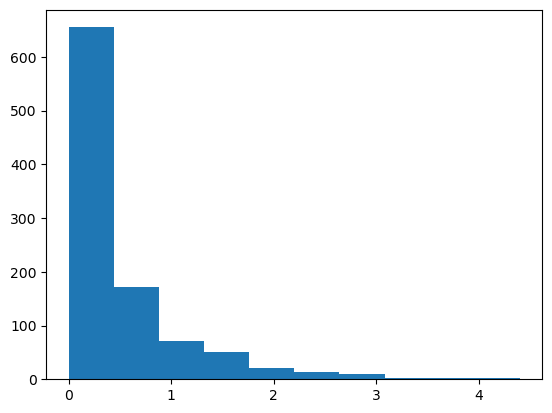

In [14]:
exp8(1000)

#### b)

Simular $X$ y $Y|X$

1. **Generación de números aleatorios uniformes**:
   - La función genera `n` números aleatorios \( u \) con una distribución uniforme en el intervalo \([0, 1]\) usando `np.random.random(n)`.

2. **Transformación logarítmica**:
   - Cada número aleatorio \( u_i \) se transforma usando una función logarítmica negativa para obtener \( x \):
   $$
   x = -\log(u)
   $$
   Esta transformación es común para generar una distribución exponencial.

3. **Generación de otro conjunto de números aleatorios**:
   - Se genera un segundo conjunto de `n` números aleatorios \( v \), también uniformemente distribuidos en el intervalo \([0, 1]\).

4. **Cálculo de la combinación de transformaciones**:
    $$ f\left(x\right)=e^{-x} $$
   - Para cada valor de \( x \), se calcula \( y \) usando la transformación logarítmica de \( v \):
   $$
   y = x - \log(1 - v)
   $$
   Esta combinación de \( x \) y \( v \) genera una nueva distribución almacenada en `y`.

5. **Cálculo y visualización del promedio**:
   - Se calcula el promedio de los valores de `y` utilizando `y.mean()` y se imprime.

6. **Visualización de la distribución**:
   - Se genera un histograma de la distribución de `y` con `plt.hist(y)` para observar su forma.
   - Finalmente, se muestra el histograma con `plt.show()`.


In [16]:
import numpy as np
import matplotlib.pyplot as plt

# Función que genera datos aleatorios y calcula una distribución combinada basada en transformaciones logarítmicas
def exp8b(n):
    # Genera 'n' números aleatorios uniformemente distribuidos en el intervalo [0, 1]
    u = np.random.random(n)

    # Calcula una transformación logarítmica de los números aleatorios 'u'
    # $$ x = -\log(u) $$
    x = -np.log(u)

    # Genera un segundo conjunto de 'n' números aleatorios uniformemente distribuidos
    v = np.random.random(n)

    # Calcula una nueva variable 'y' utilizando 'x' y una transformación de 'v'
    # $$ y = x - \log(1 - v) $$
    y = x - np.log(1 - v)

    # Calcula e imprime el promedio de 'y'
    print(y.mean())

    # Genera un histograma para visualizar la distribución de 'y'
    plt.hist(y)
    plt.show()


2.041963438213926


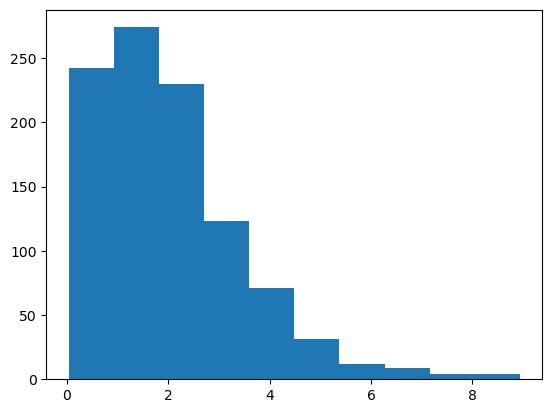

In [18]:
exp8b(1000)

Esto no es parte de mi codigo, es de chat y solo la use como ejemplo de si es que estaba graficando bien mi la funcion

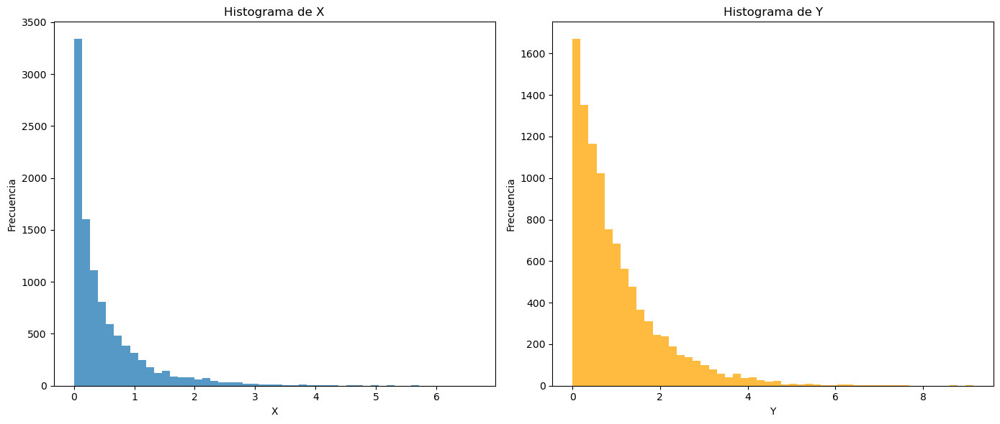

In [19]:
import numpy as np
import matplotlib.pyplot as plt

def generate_y(n):
    """ Generar muestras de Y siguiendo la distribución y * exp(-y) usando el método de aceptación-rechazo. """
    samples = []
    while len(samples) < n:
        y = np.random.exponential(1)  # Generar desde la exponencial
        u = np.random.uniform(0, y)
        if u < y:  # Condición de aceptación
            samples.append(y)
    return np.array(samples)

def generate_x(y_samples):
    """ Generar muestras de X dado que Y = y. X ~ Uniforme(0, y) """
    return np.random.uniform(0, y_samples, size=y_samples.shape)

n = 10000  # Número de muestras
y_samples = generate_y(n)
x_samples = generate_x(y_samples)

# Graficar los histogramas
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.hist(x_samples, bins=50, alpha=0.75, label='Histograma de X')
plt.title('Histograma de X')
plt.xlabel('X')
plt.ylabel('Frecuencia')

plt.subplot(1, 2, 2)
plt.hist(y_samples, bins=50, alpha=0.75, color='orange', label='Histograma de Y')
plt.title('Histograma de Y')
plt.xlabel('Y')
plt.ylabel('Frecuencia')

plt.tight_layout()
plt.show()

### Ejercicio 9

Genera un algoritmo para simular el vector aleatorio (X,Y) con la siguiente densidad:
$$f(x,y)=\frac{e^{\frac{x}{y}} e^{-y}}{y}$$
cuando x,y>0 y que vale 0 en otro caso.

1. **Generación de números aleatorios uniformes**:
   - La función genera `n` números aleatorios \( u \), con una distribución uniforme en el intervalo \([0, 1]\), usando `np.random.random(n)`.

2. **Generación de un segundo conjunto de números aleatorios**:
   - Se genera un segundo conjunto de `n` números aleatorios \( v \), también uniformemente distribuidos en el intervalo \([0, 1]\).

3. **Cálculo de la combinación de transformaciones logarítmicas**:
   - Para cada par de valores \( u_i \) y \( v_i \), se calcula el producto de sus transformaciones logarítmicas:
   $$
   x = \log(u) \cdot \log(v)
   $$
   Esto genera una nueva variable `x`, que representa el producto de los logaritmos naturales de los números aleatorios generados.

4. **Visualización de la distribución**:
   - Se genera un histograma de la distribución de `x` utilizando `plt.hist(x)` para observar la forma de la distribución de los productos.
   - Finalmente, se muestra el histograma con `plt.show()`.

In [22]:
import numpy as np
import matplotlib.pyplot as plt

# Función que genera datos aleatorios y calcula una distribución basada en el producto de transformaciones logarítmicas
def eje9(n):
    # Genera 'n' números aleatorios uniformemente distribuidos en el intervalo [0, 1]
    u = np.random.random(n)

    # Genera un segundo conjunto de 'n' números aleatorios uniformemente distribuidos
    v = np.random.random(n)

    # Calcula el producto de las transformaciones logarítmicas de 'u' y 'v'
    # $$ x = \log(u) \cdot \log(v) $$
    x = (np.log(u)) * (np.log(v))

    # Genera un histograma para visualizar la distribución de 'x'
    plt.hist(x)
    plt.show()


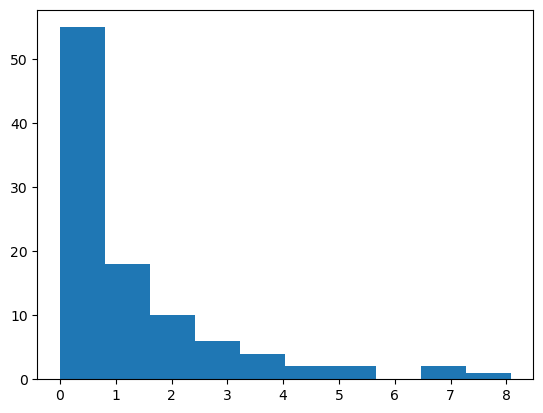

In [23]:
eje9(100)

In [24]:
import numpy as np
import plotly.graph_objs as go

# Generar el tamaño de la muestra
n = 100000

# Generar datos aleatorios
u = np.random.random(n)
v = np.random.random(n)
x = (np.log(u)) * (np.log(v))

# Crear el gráfico 3D
fig = go.Figure(data=[go.Scatter3d(
    x=u,
    y=v,
    z=x,
    mode='markers',
    marker=dict(
        size=2,           # Tamaño de los marcadores
        color=x,          # Asignar el color según los valores de x
        colorscale='Viridis',  # Escala de color
        opacity=0.8       # Opacidad de los puntos
    )
)])

# Configurar el layout del gráfico
fig.update_layout(
    title='Gráfico 3D de Dispersión para x = log(u) * log(v)',
    scene=dict(
        xaxis_title='u',
        yaxis_title='v',
        zaxis_title='x'
    ),
    autosize=False,
    width=800,
    height=600
)

# Mostrar la gráfica
fig.show()

In [26]:
import numpy as np
import plotly.graph_objs as go

# Definir la función según la especificación
def f(x, y):
    with np.errstate(divide='ignore', invalid='ignore', over='ignore'):
        if y == 0:
            return 0
        else:
            return (np.exp(-x/y) * np.exp(-y)) / y

# Crear una malla de valores x, y
x = np.linspace(0, 5, 100)
y = np.linspace(0.1, 5, 100)  # Comienza desde 0.1 para evitar la división por cero
X, Y = np.meshgrid(x, y)
Z = np.vectorize(f)(X, Y)

# Crear el gráfico 3D
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y)])

# Configurar el layout del gráfico
fig.update_layout(title='Gráfica 3D de f(x, y) = (e^{-x/y} * e^{-y}) / y',
                  scene=dict(
                      xaxis_title='X',
                      yaxis_title='Y',
                      zaxis_title='f(x, y)'),
                  autosize=False,
                  width=800,
                  height=600)

# Mostrar la gráfica
fig.show()